## Exploring morph VAE output
This notebook generates visualizations and conducts analyses to assess the biological content of the latent space representations learned by our VAE models

In [1]:
from functions.pythae_utils import *
import os
from pythae.models import VAE, VAEConfig
from pythae.trainers import BaseTrainerConfig
from pythae.pipelines.training import TrainingPipeline
from pythae.models import AutoModel
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
import umap
import numpy as np
from sklearn.preprocessing import StandardScaler
from pythae.samplers import NormalSampler

#### Get paths to data, figures, and latent space outputs

In [61]:
root = "/Users/nick/Dropbox (Cole Trapnell's Lab)/Nick/morphseq/"
# root = "E:\\Nick\\Dropbox (Cole Trapnell's Lab)\\Nick\\morphseq\\"
train_name = "20230804_vae_full"

# model_name = "20230804_vae_full_conv_z25_bs032_ne100_depth05"
model_name = "20230804_vae_full_conv_z25_bs032_ne100_depth05_matchdec01"
train_dir = os.path.join(root, "training_data", train_name)
output_dir = os.path.join(train_dir, model_name) 

# get path to model
last_training = sorted(os.listdir(output_dir))[-1]
trained_model = AutoModel.load_from_folder(
    os.path.join(output_dir, last_training, 'final_model'))

# path to figures and data
figure_path = os.path.join(output_dir, last_training, "figures")
out_figure_path = os.path.join(output_dir, last_training, "figures", "model_assessment")
if not os.path.isdir(out_figure_path):
    os.makedirs(out_figure_path)

#### Create DataLoader objects for train, eval, and test sets
- "Train" data were used to train the model
- "Eval" data were used to assess model during training
- "Test" data were untouched during training process

In [3]:
import pandas as pd
# main_dims = (576, 256) # size of images used for training
# data_transform = make_dynamic_rs_transform(main_dims)

# mode_vec = ["train", "eval", "test"]
# data_sampler_vec = []
# for mode in mode_vec:
#     ds_temp = MyCustomDataset(
#         root=os.path.join(train_dir, mode),
#         transform=data_transform
#     )
#     data_sampler_vec.append(ds_temp)

# load data frame with results
morph_df = pd.read_csv(os.path.join(figure_path, "embryo_stats_df.csv"), index_col=0)

#### Question 1: how well does the model generalize?
We can compare reconstruction error across the three data groups. In a perfect world, the model would do as well at reconstructing embryos it has never seen as on embryos that were in the training set

In [65]:
import plotly.express as px
import plotly.graph_objects as go

# load vectors that contain reconstruction loss for images
# train_mse_vec = np.load(os.path.join(figure_path, "train_set_recon_loss.npy"))
# eval_mse_vec = np.load(os.path.join(figure_path, "eval_set_recon_loss.npy"))
# test_mse_vec = np.load(os.path.join(figure_path, "test_set_recon_loss.npy"))

# normalizing constant
# global_min = np.min([train_mse_vec, eval_mse_vec, test_mse_vec])

# calculate averages
# train_mu = np.mean(train_mse_vec-global_min)
# eval_mu = np.mean(eval_mse_vec-global_min)
# test_mu = np.mean(test_mse_vec-global_min)

fig = px.histogram(morph_df, x="recon_mse", color="train_cat", histnorm='probability density', 
                   title="Comparing image reconstruction quality",
                   labels=dict(recon_mse="reconstruction error (MSE)", train_cat="training class"))

# fig.update_layout(legend=[ f"training images (mu={np.round(train_mu)})", f"eval images (mu={np.round(eval_mu)})", f"test images (mu={np.round(test_mu)})"]) 


fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.5)

fig.show()
fig.write_image(os.path.join(out_figure_path, "tet_image_recon_hist.png"))

In [70]:
fig = px.box(morph_df, x="train_cat", y="recon_mse", color="train_cat",
             title="Comparing image reconstruction quality",
             labels=dict(recon_mse="reconstruction error (MSE)", train_cat="training class"))
fig.show()
fig.write_image(os.path.join(out_figure_path, "tet_image_recon_box.png"))

Note that the train and eval data compositions should be identical, so likely the eval set is a slightly better point of comparison. Overall, we see that the model does better on training data, but not overwhelmingly so. 

Let's look at a couple comparison images to get a sense for the qualitative implications of these reconstruction error values.


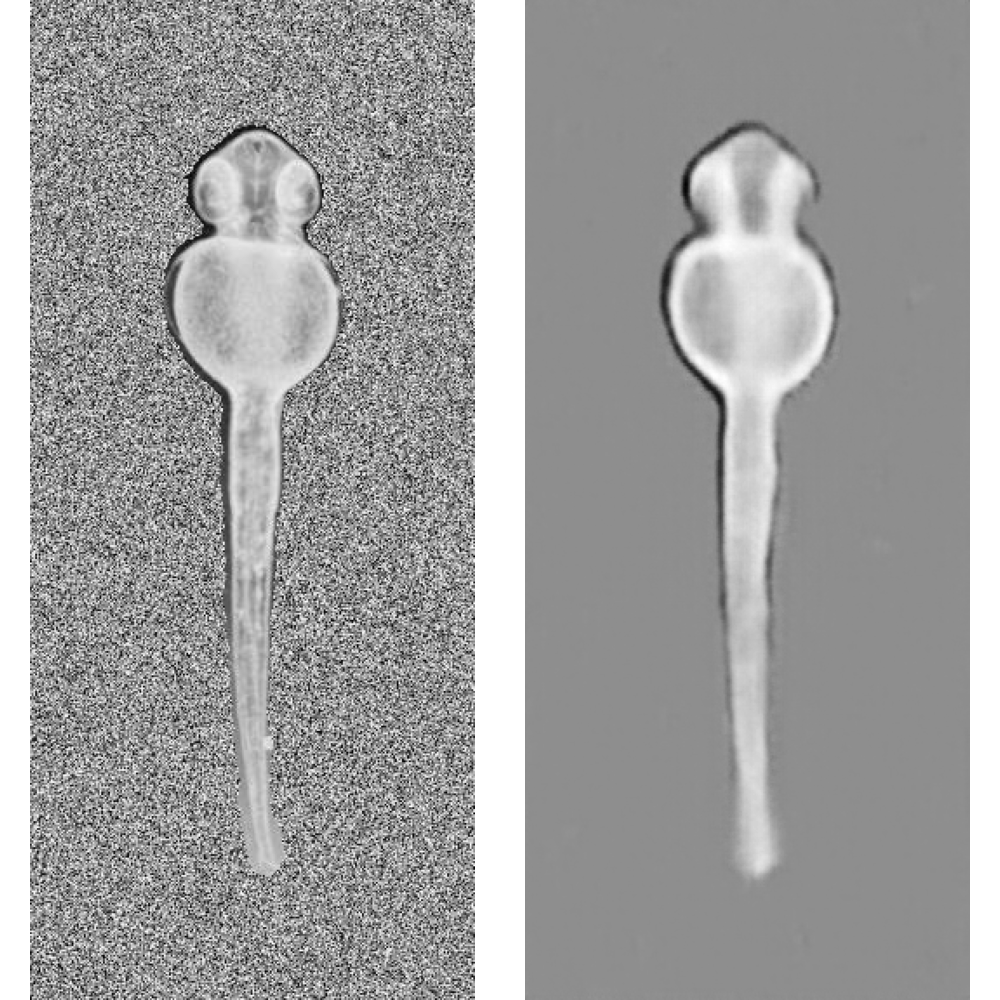

In [6]:
from skimage import io
import plotly.express as px

im_train_avg = io.imread("/Users/nick/Dropbox (Cole Trapnell's Lab)/Nick/morphseq/training_data/20230804_vae_full/20230804_vae_full_conv_z25_bs032_ne100_depth05_matchdec01/VAE_training_2023-08-09_14-12-59/figures/train_images/im_0229_loss06735.tiff")

im_test_avg = io.imread("/Users/nick/Dropbox (Cole Trapnell's Lab)/Nick/morphseq/training_data/20230804_vae_full/20230804_vae_full_conv_z25_bs032_ne100_depth05_matchdec01/VAE_training_2023-08-09_14-12-59/figures/test_images/im_2724_loss06848.tiff")

fig = px.imshow(im_train_avg, title="Representative training image")
fig.show()


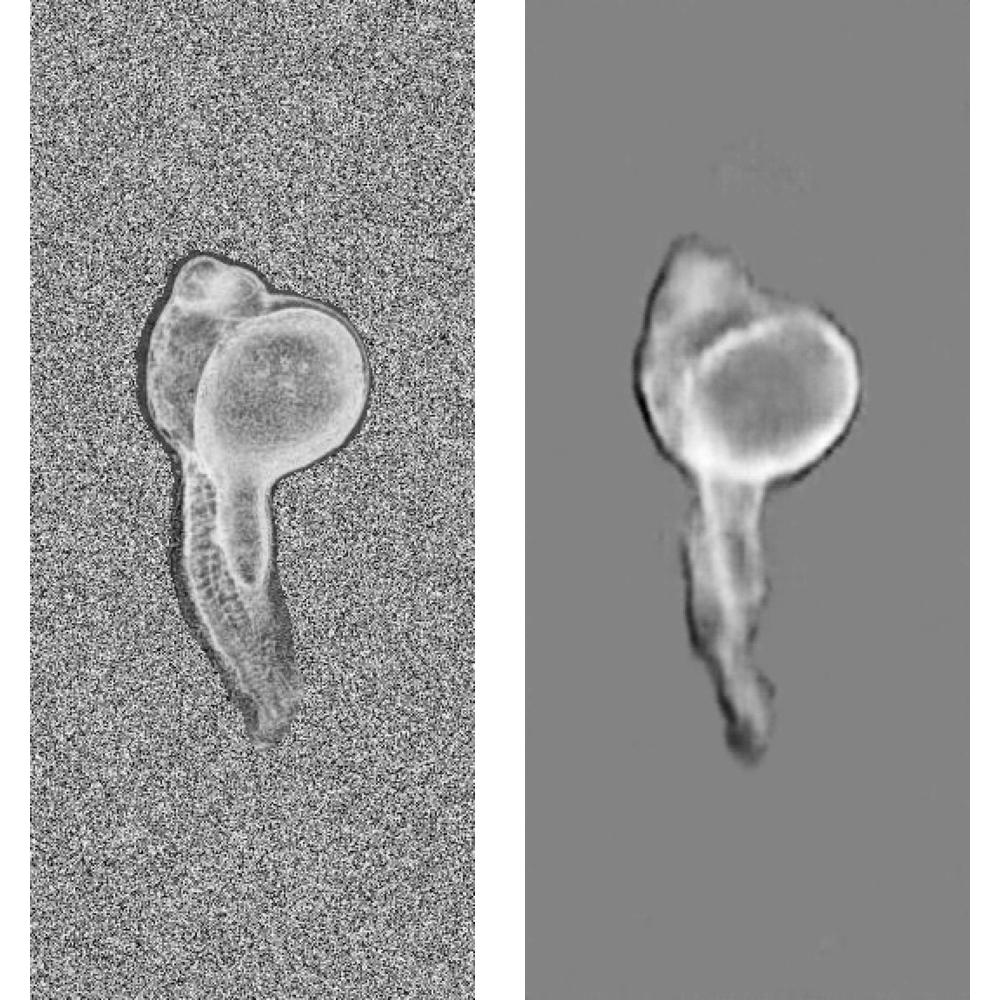

In [7]:
fig = px.imshow(im_test_avg, title="Representative test image")
fig.show()

#### Question 2: What does latent space "look" like?
We cannot visualize the full space, but we can use UMAP to generate reduced representations. Not clear how informative this kind of thing is, but worth having for reference

In [80]:
# load arrays with UMAP embeddings

fig = px.scatter(morph_df, x="UMAP_00", y="UMAP_01", opacity=0.5, template="plotly",
                title="UMAP representation of morphology latent space",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2"))

fig.update_traces(marker=dict(size=5,
                              color='gray'))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_all.png"))

In [82]:
# load arrays with UMAP embeddings

fig = px.scatter(morph_df, x="UMAP_00", y="UMAP_01", color="train_cat", opacity=0.5, template="plotly",
                title="Latent space colored by training class",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2", train_cat="training class"))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_train_class.png"))

In [84]:
morph_df["experiment_id"] = morph_df["experiment_date"].astype('category',copy=True)

fig = px.scatter(morph_df, x="UMAP_00", y="UMAP_01", color="experiment_id", opacity=0.5, template="plotly",
                title="Latent space colored by experiment ID",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2", experiment_id="experiment ID"))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_experiment_id.png"))

In [87]:
fig = px.scatter(morph_df, x="UMAP_00", y="UMAP_01", color="master_perturbation", opacity=0.25, template="plotly",
                title="Latent space colored by experimental perturbation",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2", master_perturbation="perturbation"))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_perturbation.png"))

Let's zoom in on a few specific perturbations

In [107]:
ft_indices = np.where((morph_df["master_perturbation"]=='wck-AB') | (morph_df["master_perturbation"]=='gdf3'))

fig = px.scatter(morph_df.iloc[ft_indices], x="UMAP_00", y="UMAP_01", color="master_perturbation", opacity=0.25, template="plotly",
                title="Latent space colored by experimental perturbation",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2", master_perturbation="perturbation"))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_ab_gdf3.png"))

In [101]:
fgf_indices = [i for i in range(morph_df.shape[0]) if 'Fgf' in morph_df.loc[i, "master_perturbation"]]
wck_indices = np.where((morph_df["master_perturbation"]=='wck-AB'))[0]
ft_indices = np.asarray(wck_indices.tolist() + fgf_indices)

fig = px.scatter(morph_df.iloc[ft_indices], x="UMAP_00", y="UMAP_01", color="master_perturbation", opacity=0.25, template="plotly",
                title="Latent space colored by experimental perturbation",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2", master_perturbation="perturbation"))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_ab_fgf.png"))

In [102]:
shh_indices = [i for i in range(morph_df.shape[0]) if 'Shh' in morph_df.loc[i, "master_perturbation"]]
wck_indices = np.where((morph_df["master_perturbation"]=='wck-AB'))[0]
ft_indices = np.asarray(wck_indices.tolist() + shh_indices)

fig = px.scatter(morph_df.iloc[ft_indices], x="UMAP_00", y="UMAP_01", color="master_perturbation", opacity=0.25, template="plotly",
                title="Latent space colored by experimental perturbation",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2", master_perturbation="perturbation"))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_ab_shh.png"))

In [104]:
fig = px.scatter(morph_df, x="UMAP_00", y="UMAP_01", color="predicted_stage_hpf", opacity=0.5, template="plotly",
                title="Latent space colored by developemntal age",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2", predicted_stage_hpf="stage (hpf)"))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_age.png"))

In [106]:
fig = px.scatter(morph_df.iloc[wck_indices], x="UMAP_00", y="UMAP_01", color="predicted_stage_hpf", opacity=0.5, template="plotly",
                title="Latent space colored by experimental perturbation",
                labels=dict(UMAP_00="UMAP dim 1", UMAP01="UMAP dim 2", predicted_stage_hpf="stage (hpf)"))

fig.show()
fig.write_image(os.path.join(out_figure_path, "latent_UMAP_age_ab_only.png"))

### Next steps

1. **Dig further into latent space**
    - What causes the mirroring in UMAP space?
    - What do the outlier points look like? 
    
<br>

2. **Build quantitative pipeline for assessing information content of latent space**
    - Use simple NN to predict age and perturbation from latent space
    - Use multivariate regression (or similar) to look at how much info is _linearly_ decodable
    - Short-term: use these methods to identify optimal model architecture and hyperparameters
    - Mid-term: I want to use a simple linear model to reduce latent space to a biologically salient subspace
    
<br>

3. **Improve and extend the model**
    - Deeper decoder to improve image fidelity
    - Try incorporating embryoNET as the encoder
    
<br>

4. **Test VAE variants to improve biological salience of latent space**
    - TC-VAE to inforce statistical independent latent variables
    - Apply metric constraint to incentivize model to learn representations of key biological variables (time, genotype) while minimizing the impact of "nuisance variables (embryo pose, experimental variability, etc.) 

In [111]:
import umap
import hdbscan
import sklearn.cluster as cluster

labels = hdbscan.HDBSCAN(
    min_samples=10,
    min_cluster_size=500,
).fit_predict(morph_df.loc[:, ["UMAP_00", "UMAP_01"]])

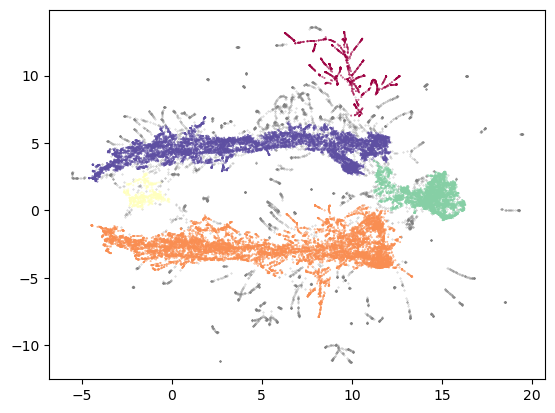

In [112]:
from matplotlib import pyplot as plt

umap_array = morph_df.loc[:, ["UMAP_00", "UMAP_01"]].to_numpy()
clustered = (labels >= 0)
plt.scatter(umap_array[~clustered, 0],
            umap_array[~clustered, 1],
            color=(0.5, 0.5, 0.5),
            s=0.1,
            alpha=0.5)
plt.scatter(umap_array[clustered, 0],
            umap_array[clustered, 1],
            c=labels[clustered],
            s=0.1,
            cmap='Spectral');

plt.show()

## How do we interpret the dual developmental forks?
One hypothesis is that this could reflect information about embryo orientation

In [48]:
# plot two example embryos from the top and bottom forks
eid_vec =  [morph_df.loc[i, "snip_id"][:-10] for i in range(morph_df.shape[0])]
morph_df["embryo_id"] = eid_vec

top_id = "20230531_D11"
bottom_id = "20230615_B09"

fig = px.scatter(morph_df, x="UMAP_00", y="UMAP_01", opacity=0.01, template="plotly",
                title="VAE latent space by age")

fig.add_trace(go.Scatter(x=morph_df["UMAP_00"].iloc[np.where(np.asarray(eid_vec)==top_id)[0]],
                         y=morph_df["UMAP_01"].iloc[np.where(np.asarray(eid_vec)==top_id)[0]],
                         mode="markers+lines", name=top_id))

fig.add_trace(go.Scatter(x=morph_df["UMAP_00"].iloc[np.where(np.asarray(eid_vec)==bottom_id)[0]],
                         y=morph_df["UMAP_01"].iloc[np.where(np.asarray(eid_vec)==bottom_id)[0]],
                         mode="markers+lines", name=bottom_id, 
                         marker=dict(
                         color=morph_df["predicted_stage_hpf"].iloc[np.where(np.asarray(eid_vec)==bottom_id)[0]])))

fig.show()

**Let's examine embryos from either side of the fork**


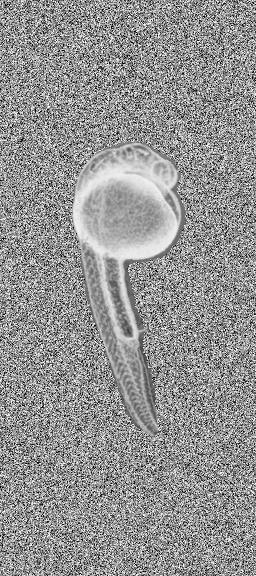

In [52]:
plot_id = "20230615_B09"
train_cat = morph_df["train_cat"].iloc[np.where(np.asarray(eid_vec)==plot_id)[0][0]]
frame_ind = 25 # which frame to pull
snip_id = morph_df["snip_id"].iloc[np.where(np.asarray(eid_vec)==plot_id)[0][frame_ind]]
load_path = os.path.join(train_dir, train_cat, plot_id[:8], snip_id + ".jpg")

im = io.imread(load_path)
px.imshow(im)


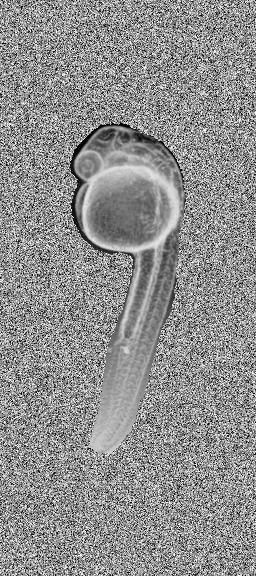

In [53]:
plot_id = "20230531_D11"
train_cat = morph_df["train_cat"].iloc[np.where(np.asarray(eid_vec)==plot_id)[0][0]]
frame_ind = 20 # which frame to pull
snip_id = morph_df["snip_id"].iloc[np.where(np.asarray(eid_vec)==plot_id)[0][frame_ind]]
load_path = os.path.join(train_dir, train_cat, plot_id[:8], snip_id + ".jpg")

im = io.imread(load_path)
px.imshow(im)

Wow, yes, it looks like the two forks reflect L-R variations on the lateral orientation. I wonder if that blob in the middle towards the end of the fork reflects embryos that are predominantly Dorsal or Ventral

In [60]:
middle_id = "20230620_G07"

fig = px.scatter(morph_df, x="UMAP_00", y="UMAP_01", opacity=0.01, template="plotly")

fig.add_trace(go.Scatter(x=morph_df["UMAP_00"].iloc[np.where(np.asarray(eid_vec)==middle_id)[0]],
                         y=morph_df["UMAP_01"].iloc[np.where(np.asarray(eid_vec)==middle_id)[0]],
                         mode="markers+lines", name=middle_id,
                         marker=dict(
                         color=morph_df["predicted_stage_hpf"].iloc[np.where(np.asarray(eid_vec)==middle_id)[0]])))

fig.show()


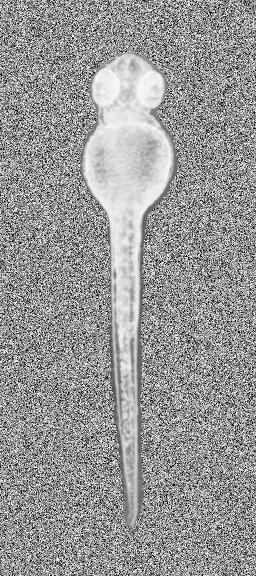

In [59]:
plot_id = "20230620_G07"
umap01_vec = morph_df["UMAP_01"].to_numpy()
p_indices = np.where((np.asarray(eid_vec)==plot_id) &
                    (umap01_vec>=0) &
                    (umap01_vec<=2))[0]

train_cat = morph_df["train_cat"].iloc[p_indices[0]]
frame_ind = 20 # which frame to pull
snip_id = morph_df["snip_id"].iloc[p_indices[-1]]
load_path = os.path.join(train_dir, train_cat, plot_id[:8], snip_id + ".jpg")

im = io.imread(load_path)
px.imshow(im)

## How much biological information does latent space contain? 
We can get at this question by trying to predict key biological covariates from the values of the 25 latent encodings. We will test both how much information is available overall (using an MLP) and how much information is linearly decodable.

Let's look at MLP first. We will use the "train" and "eval" partitions to train the classifier, and will test it out on the "test" partition. Let's look at time first

In [219]:
from sklearn.neural_network import MLPRegressor
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split

train_indices = np.where((morph_df["train_cat"]=="train") | (morph_df["train_cat"]=="test"))[0]
test_indices = np.where(morph_df["train_cat"] =="eval")[0]

# extract target vector
y_train = morph_df["predicted_stage_hpf"].iloc[train_indices].to_numpy().astype(float)
y_test = morph_df["predicted_stage_hpf"].iloc[test_indices].to_numpy().astype(float)

# extract predictor variables
mu_indices = [i for i in range(len(morph_df.columns)) if "z_mu_" in morph_df.columns[i]]
X_train = morph_df.iloc[train_indices, mu_indices].to_numpy().astype(float)
X_test = morph_df.iloc[test_indices, mu_indices].to_numpy().astype(float)

In [220]:
clf = MLPRegressor(random_state=1, max_iter=1000).fit(X_train, y_train)

In [222]:
y_test_pd = clf.predict(X_test)
y_train_pd = clf.predict(X_train)
R2_nl = clf.score(X_test, y_test)
R2_train_nl = clf.score(X_train, y_train)
print(R2_train_nl)

perturbation_vec_test = morph_df["master_perturbation"].iloc[test_indices].values

fig = px.scatter(x=y_test, y=y_test_pd, opacity=0.5,
                title=f"Predicted vs. Actual Developmental Ages (R^2={np.round(R2_nl,2)})")
fig.update_xaxes(title_text='actual age (hpf)')
fig.update_yaxes(title_text='predicted age (hpf)')
fig.show()


0.9655580139999892


### Next, examine whether latent space can distinguish between wt and gdf3 embryos

In [223]:
from sklearn.neural_network import MLPClassifier
gdf3_class_train = np.asarray(morph_df["master_perturbation"].iloc[train_indices])
train_gdf3_sub_indices = np.where(gdf3_class_train=="gdf3")[0]
train_wck_sub_indices = np.random.choice(np.where(gdf3_class_train=="wck-AB")[0], len(train_gdf3_sub_indices), replace=False)
train_sub_indices = np.asarray(train_gdf3_sub_indices.tolist() + train_wck_sub_indices.tolist())

gdf3_class_test = np.asarray(morph_df["master_perturbation"].iloc[test_indices])
test_sub_indices = np.where((gdf3_class_test=="wck-AB") | (gdf3_class_test=="gdf3"))[0]



In [224]:
clf_gdf3 = MLPClassifier(random_state=1, max_iter=1000).fit(X_train[train_sub_indices], gdf3_class_train[train_sub_indices])

In [225]:
accuracy = clf_gdf3.score(X_test[test_sub_indices], gdf3_class_test[test_sub_indices])
print(accuracy)

class_probs = clf_gdf3.predict_proba(X_test[test_sub_indices])
class_log_probs = np.log2(class_probs)
class_log_probs[np.where(np.isinf(class_log_probs))] = -1e6 # any valus should do here
pd_entropy = np.sum(np.multiply(class_log_probs, class_probs), axis=1)

fig = px.scatter(morph_df.iloc[test_indices[test_sub_indices]], x="UMAP_00", y="UMAP_01", color=pd_entropy)
fig.show()

0.9281836130306022


/var/folders/m7/tpjttxb92tl8b4c9svgvgby00000gn/T/ipykernel_86118/3024436183.py:5: RuntimeWarning:

divide by zero encountered in log2



In [226]:
class_predictions = clf_gdf3.predict(X_test[test_sub_indices])
true_vec = gdf3_class_test[test_sub_indices]
ab_right_indices = np.where((class_predictions==true_vec) & (true_vec=='wck-AB'))[0]
ab_wrong_indices = np.where((class_predictions!=true_vec) & (true_vec=='wck-AB'))[0]
gdf3_right_indices = np.where((class_predictions==true_vec) & (true_vec=='gdf3'))[0]
gdf3_wrong_indices = np.where((class_predictions!=true_vec) & (true_vec=='gdf3'))[0]

# extract UMAP array
umap_array = morph_df[["UMAP_00", "UMAP_01"]].iloc[test_indices[test_sub_indices]].to_numpy()

# fig = px.scatter(morph_df.iloc[train_sub_indices], x="UMAP_00", y="UMAP_01", opacity=0.05)

# fig.update_traces(marker=dict(color='gray'),
#                   name="training data")

fig = go.Figure()

fig.add_trace(go.Scatter(x=umap_array[ab_right_indices, 0], y=umap_array[ab_right_indices, 1], mode="markers",
                        marker=dict(color="lightblue", opacity=0.5), name='wck-AB (correct)'))

fig.add_trace(go.Scatter(x=umap_array[ab_wrong_indices, 0], y=umap_array[ab_wrong_indices, 1], mode="markers",
                        marker=dict(color="blue", opacity=0.5), name='wck-AB (incorrect)'))  

fig.add_trace(go.Scatter(x=umap_array[gdf3_right_indices, 0], y=umap_array[gdf3_right_indices, 1], mode="markers",
                        marker=dict(color="lightsalmon", opacity=0.5), name='gdf3 (correct)'))

fig.add_trace(go.Scatter(x=umap_array[gdf3_wrong_indices, 0], y=umap_array[gdf3_wrong_indices, 1], mode="markers",
                        marker=dict(color="red", opacity=0.5), name='gdf3 (incorrect)'))  

fig.show()

Could a classifier trained on just the UMAP coordinates do better (it should not!)

In [227]:
# does it do better with a simpler space?
umap_array_train = morph_df[["UMAP_00", "UMAP_01"]].iloc[train_indices[train_sub_indices]].to_numpy()
clf_gdf3_umap = MLPClassifier(random_state=1, max_iter=1000).fit(umap_array_train, gdf3_class_train[train_sub_indices])

In [228]:
accuracy_umap = clf_gdf3_umap.score(umap_array, gdf3_class_test[test_sub_indices])
print(accuracy_umap)

class_predictions = clf_gdf3_umap.predict(umap_array)
ab_right_indices = np.where((class_predictions==true_vec) & (true_vec=='wck-AB'))[0]
ab_wrong_indices = np.where((class_predictions!=true_vec) & (true_vec=='wck-AB'))[0]
gdf3_right_indices = np.where((class_predictions==true_vec) & (true_vec=='gdf3'))[0]
gdf3_wrong_indices = np.where((class_predictions!=true_vec) & (true_vec=='gdf3'))[0]

# extract UMAP array
umap_array = morph_df[["UMAP_00", "UMAP_01"]].iloc[test_indices[test_sub_indices]].to_numpy()

# fig = px.scatter(morph_df.iloc[train_sub_indices], x="UMAP_00", y="UMAP_01", opacity=0.05)

# fig.update_traces(marker=dict(color='gray'),
#                   name="training data")

fig = go.Figure()

fig.add_trace(go.Scatter(x=umap_array[ab_right_indices, 0], y=umap_array[ab_right_indices, 1], mode="markers",
                        marker=dict(color="lightblue", opacity=0.5), name='wck-AB (correct)'))

fig.add_trace(go.Scatter(x=umap_array[ab_wrong_indices, 0], y=umap_array[ab_wrong_indices, 1], mode="markers",
                        marker=dict(color="blue", opacity=0.5), name='wck-AB (incorrect)'))  

fig.add_trace(go.Scatter(x=umap_array[gdf3_right_indices, 0], y=umap_array[gdf3_right_indices, 1], mode="markers",
                        marker=dict(color="lightsalmon", opacity=0.5), name='gdf3 (correct)'))

fig.add_trace(go.Scatter(x=umap_array[gdf3_wrong_indices, 0], y=umap_array[gdf3_wrong_indices, 1], mode="markers",
                        marker=dict(color="red", opacity=0.5), name='gdf3 (incorrect)'))  

fig.show()

0.8553800592300099


### Use multivariate linear regression to test linear decodability of temporal information

In [241]:
from sklearn import linear_model
import statsmodels.api as sm
from scipy import stats

reg = linear_model.LinearRegression().fit(X_train, y_train)
# X2 = sm.add_constant(X_train)
# est = sm.OLS(y_train, X2)
# est2 = est.fit()
# print(est2.summary())

R2_lin = reg.score(X_test, y_test)
print(R2_lin)
y_test_pd_lin = reg.predict(X_test)

fig = px.scatter(x=y_test, y=y_test_pd_lin, opacity=0.5,
                title=f"Predicted vs. Actual Developmental Ages (R^2={np.round(R2_lin,2)})")
fig.update_xaxes(title_text='actual age (hpf)')
fig.update_yaxes(title_text='predicted age (hpf)')
fig.show()

0.7211832482447955


### Now assess linear model for gdf3 classification task

In [242]:
from sklearn.linear_model import LogisticRegression
clf_gdf3_lin = LogisticRegression(random_state=0).fit(X_train[train_sub_indices], gdf3_class_train[train_sub_indices])

In [244]:
accuracy_lin = clf_gdf3_lin.score(X_test[test_sub_indices], gdf3_class_test[test_sub_indices])
print(accuracy_lin)

class_predictions_lin = clf_gdf3_lin.predict(X_test[test_sub_indices])

ab_right_indices = np.where((class_predictions_lin==true_vec) & (true_vec=='wck-AB'))[0]
ab_wrong_indices = np.where((class_predictions_lin!=true_vec) & (true_vec=='wck-AB'))[0]
gdf3_right_indices = np.where((class_predictions_lin==true_vec) & (true_vec=='gdf3'))[0]
gdf3_wrong_indices = np.where((class_predictions_lin!=true_vec) & (true_vec=='gdf3'))[0]

fig = go.Figure()

fig.add_trace(go.Scatter(x=umap_array[ab_right_indices, 0], y=umap_array[ab_right_indices, 1], mode="markers",
                        marker=dict(color="lightblue", opacity=0.5), name='wck-AB (correct)'))

fig.add_trace(go.Scatter(x=umap_array[ab_wrong_indices, 0], y=umap_array[ab_wrong_indices, 1], mode="markers",
                        marker=dict(color="blue", opacity=0.5), name='wck-AB (incorrect)'))  

fig.add_trace(go.Scatter(x=umap_array[gdf3_right_indices, 0], y=umap_array[gdf3_right_indices, 1], mode="markers",
                        marker=dict(color="lightsalmon", opacity=0.5), name='gdf3 (correct)'))

fig.add_trace(go.Scatter(x=umap_array[gdf3_wrong_indices, 0], y=umap_array[gdf3_wrong_indices, 1], mode="markers",
                        marker=dict(color="red", opacity=0.5), name='gdf3 (incorrect)'))  

fig.show()

0.8235439289239882
